#### Imports

In [35]:
from pathlib import Path
from imageio import imread
from PIL import Image
from skimage import io as skio
from skimage import transform as sktr
import os
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import clear_output

import sys
sys.path.append('../../git/omnigan/')

from omnigan.data import encode_mask_label
from omnigan.tutils import normalize
from omnigan.transforms import RandomCrop, Resize
from omnigan.transforms import PrepareInference, PrepareTest
from omnigan.utils import find_images

from skimage import filters 
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.metrics import fbeta_score

#### Constants

In [2]:
# Paths
data_path = '/home/alex/Dropbox/ccai/data/'
imgs_orig_path = os.path.join(data_path, 'floodmasks_eval/imgs')
labels_path = os.path.join(data_path, 'floodmasks_eval/labels')
preds_path = os.path.join(data_path, 'flood_eval_inferred_masks')

# Labels dict
# 0: cannot flood
# 1: must flood
# 2: could flood
classes_dict={0: [255, 0, 0, 255], 1: [0, 0, 255, 255], 2: [0, 0, 0, 255]}

### Image transforms (numpy)

#### Resize

In [3]:
def resize(x, target_size):
    shape = x.shape
    h = shape[0]
    w = shape[1]
    if w > h:
        target_h = target_size
        target_w = int(w * (float(target_size) / h))
    elif h > w:
        target_w = target_size
        target_h = int(h * (float(target_size) / w))
    else:
        target_h = target_size
        target_w = target_size
    return sktr.resize(x, (target_h, target_w), preserve_range=True).astype(np.uint8)

#### Crop

In [4]:
def central_crop(x, target_size):
    assert isinstance(target_size, (int, tuple, list))
    if isinstance(target_size, int):
        target_h = target_w = target_size
    else:
        target_h = target_size[0]
        target_w = target_size[1]
        
    shape = x.shape
    h = shape[0]
    w = shape[1]
    
    i_init = (h - target_h) // 2
    j_init = (w - target_w) // 2
    
    if np.ndim(x) == 3:
        return x[i_init : i_init + target_h, j_init : j_init + target_w, :]
    elif np.ndim(x) == 2:
        return x[i_init : i_init + target_h, j_init : j_init + target_w]
    else:
        raise NotImplementedError

### Pre-processing

#### preprop_orig

In [5]:
def preprop_orig(x, target_size):
    return central_crop(resize(x, target_size), target_size).astype(np.uint8)

#### preprop_label

In [6]:
def encode_segmap(seg, classes_dict):
    diff = np.zeros((len(classes_dict.keys()), seg.shape[0], seg.shape[1]))
    for cindex, cvalue in classes_dict.items():
        diff[cindex, :, :] = np.sum(np.abs(seg - np.tile(cvalue, (seg.shape[0], seg.shape[1], 1))), axis=2)
    return np.argmin(diff, axis=0)

In [7]:
def preprop_label(x, target_size):
    return encode_mask_label(central_crop(resize(x, target_size), target_size).astype(np.uint8),
                         domain='flood')

#### preprop_pred

In [8]:
def preprop_pred(x, target_size):
    return np.divide(central_crop(resize(x, target_size), target_size), np.max(x))

### Edge coherence

#### plot_edges

In [9]:
def plot_edges(img, label, pred, dpi=200):
    f, axes = plt.subplots(1, 3, dpi=dpi)
    axes[0].imshow(img)
    axes[1].imshow(img)
    axes[1].imshow(1.0 - label, cmap='gray', alpha=0.5)
    axes[2].imshow(img)
    axes[2].imshow(1.0 - pred, cmap='gray', alpha=0.5)
    for ax in axes:
        ax.axis('off')
        
    return f

#### edge_coherence

In [10]:
def edge_coherence(pred, label, must_label=1, bin_th=0.5):
    # Keep must flood label only
    label[label != must_label] = -1
    label[label == must_label] = 1
    label[label != must_label] = 0
    label = np.asarray(label, dtype=float)
    
    # Binarize prediction
    pred = np.asarray(pred > bin_th, dtype=float)
    
    # Compute edges
    pred = filters.sobel(pred)
    label = filters.sobel(label)
    
    # Location of edges
    pred_edges = np.argwhere(pred > 0)
    label_edges = np.argwhere(label > 0)
    
    # Normalized pairwise distances between pred and label
    dist_mat = np.divide(euclidean_distances(pred_edges, label_edges), pred.shape[0])
    
    # Standard deviation of the minimum distance from pred to label
    edge_coherence = np.std(np.min(dist_mat, axis=1))
    
    return edge_coherence, pred, label

### Metrics

#### False positives: prediction error on cannot flood

In [11]:
def pred_cannot(pred, labels, label_cannot=0):
    """
    Compute false positive ratio and its map. Since the predictions are soft, the errors are weighted.
    
    Returns
    -------
    fp_map : ndarray
        The map of false positives: predicted mask on cannot flood
        
    fpr : float
        False positive ratio
    """
    fp_map = pred * np.asarray(labels == label_cannot, dtype=int)
    fpr = np.sum(fp_map) / np.sum(labels == label_cannot)
    return fp_map, fpr

#### False negatives: missed predictions on must flood

In [12]:
def missed_must(pred, labels, label_must=1):
    """
    Compute false negatives ratio and its map. Since the predictions are soft, the errors are weighted.
    
    Returns
    -------
    fn_map : ndarray
        The map of false negatives: missed mask on must flood
        
    fnr : float
        False negatives ratio
    """
    fn_map = (1. - pred) * np.asarray(labels == label_must, dtype=int)
    fnr = np.sum(fn_map) / np.sum(labels == label_must)
    return fn_map, fnr

#### Predictions on may flood

In [13]:
def may_flood(pred, labels, label_may=2):
    """
    Compute "may" negatives and "may" positives ratios and their map. 
    Since the predictions are soft, the "errors" are weighted.
    
    Returns
    -------
    may_neg_map : ndarray
        The map of "may" negatives
    
    may_pos_map : ndarray
        The map of "may" positives
        
    mnr : float
        "May" negatives ratio
        
    mpr : float
        "May" positives ratio
    """
    may_neg_map = (1. - pred) * np.asarray(labels == label_may, dtype=int)
    may_pos_map = pred * np.asarray(labels == label_may, dtype=int)
    mnr = np.sum(may_neg_map) / np.sum(labels == label_may)
    mpr = np.sum(may_pos_map) / np.sum(labels == label_may)
    return may_neg_map, may_pos_map, mnr, mpr

#### Compute additional metrics

In [63]:
def compute_metrics(pred, labels, label_cannot=0, label_must=1):
    tp_map = pred * np.asarray(labels == label_must, dtype=int)
    tpr = np.sum(tp_map) / np.sum(labels == label_must)
    tn_map = (1. - pred) * np.asarray(labels == label_cannot, dtype=int)
    tnr = np.sum(tn_map) / np.sum(labels == label_cannot)
    fp_map = pred * np.asarray(labels == label_cannot, dtype=int)
    fn_map = (1. - pred) * np.asarray(labels == label_must, dtype=int)
    precision = np.sum(tp_map) / (np.sum(tp_map) + np.sum(fp_map))
    f1 = (2 * precision * tpr) / (precision + tpr)
    f05 = ((1 + 0.5**2) * precision * tpr) / (0.5**2 * precision + tpr)
    f005 = ((1 + 0.05**2) * precision * tpr) / (0.05**2 * precision + tpr)
    f2 = ((1 + 2.**2) * precision * tpr) / (2.**2 * precision + tpr)
    f4 = ((1 + 4.**2) * precision * tpr) / (4.**2 * precision + tpr)
    return tpr, tnr, precision, f1, f05, f005, f2, f4

In [15]:
def confusion_matrix(tpr, tnr, fpr, fnr, mpr, mnr):
    # Compute mean and standard deviations over all samples
    tpr_m = np.mean(tpr)
    tpr_s = np.std(tpr)
    tnr_m = np.mean(tnr)
    tnr_s = np.std(tnr)
    fpr_m = np.mean(fpr)
    fpr_s = np.std(fpr)
    fnr_m = np.mean(fnr)
    fnr_s = np.std(fnr)
    mpr_m = np.mean(mpr)
    mpr_s = np.std(mpr)
    mnr_m = np.mean(mnr)
    mnr_s = np.std(mnr)
    
    # Assertions
    assert np.isclose(tpr_m, 1. - fnr_m)
    assert np.isclose(tnr_m, 1. - fpr_m)
    assert np.isclose(mpr_m, 1. - mnr_m)
    
    confusion_matrix = np.zeros((3, 3))
    confusion_matrix[0, 0] = tnr_m
    confusion_matrix[0, 1] = fnr_m
    confusion_matrix[0, 2] = mnr_m
    confusion_matrix[1, 0] = fpr_m
    confusion_matrix[1, 1] = tpr_m
    confusion_matrix[1, 2] = mpr_m
    confusion_matrix[2, 2] = 0.
    
    return confusion_matrix

# Numpy

## Read data

#### Read all files

In [16]:
imgs_paths = list(Path(imgs_orig_path).glob('*'))
labels_paths = list(Path(labels_path).glob('*'))
preds_paths = list(Path(preds_path).glob('*'))

### Compute and plot metrics

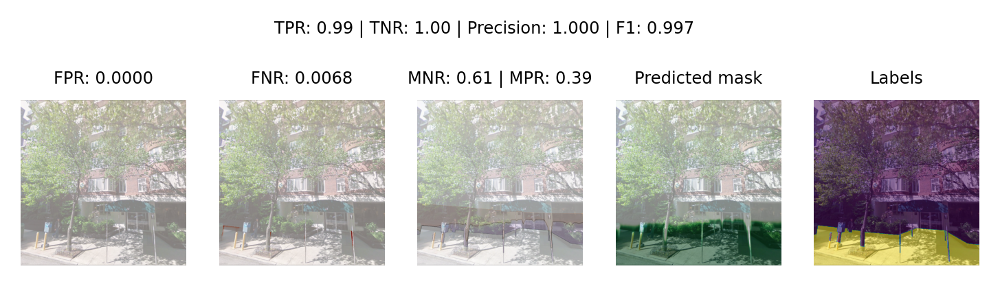

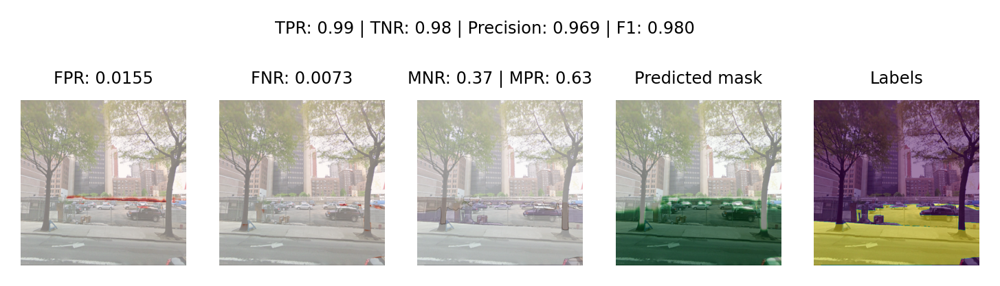

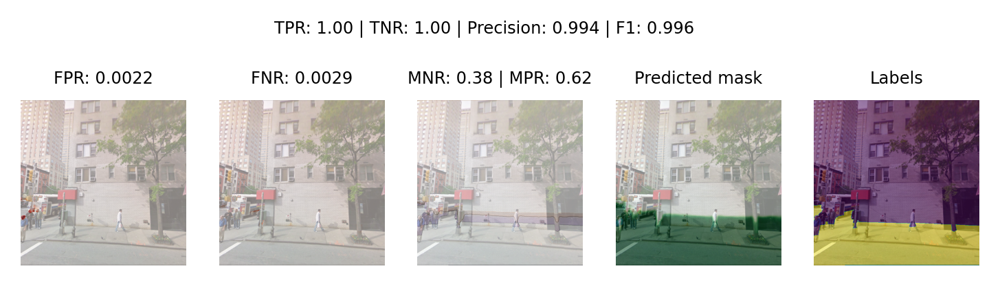

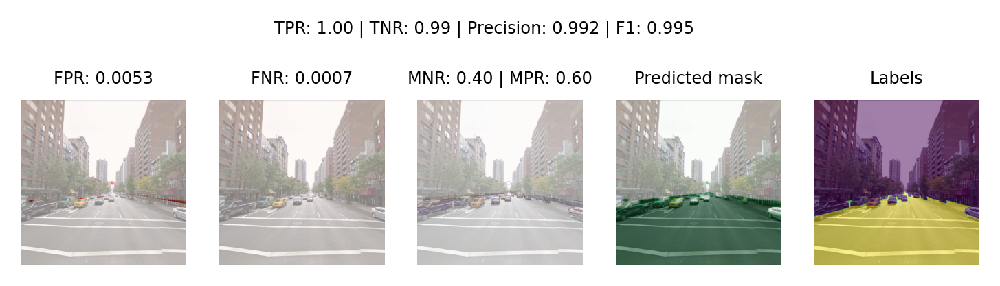

In [17]:
fpr_list = []
fnr_list = []
mnr_list = []
mpr_list = []
tpr_list = []
tnr_list = []
precision_list = []
f1_list = []

for idx, (img_path, label_path, pred_path) in enumerate(
        zip(*(sorted(imgs_paths), sorted(labels_paths), sorted(preds_paths)))):
    
    img = preprop_orig(imread(img_path), target_size=640)
    labels = preprop_label(imread(label_path), target_size=640)
    labels = np.squeeze(labels)
    pred = preprop_pred(imread(pred_path), target_size=640)  
    
    fp_map, fpr = pred_cannot(pred, labels, label_cannot=0)
    fn_map, fnr = missed_must(pred, labels, label_must=1)
    may_neg_map, may_pos_map, mnr, mpr = may_flood(pred, labels, label_may=2)
    tpr, tnr, precision, f1, _, _, _ = compute_metrics(pred, labels, label_cannot=0, label_must=1)
    
    metric, pred_edge, label_edge = edge_coherence(pred, labels)
    
    f, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, dpi=300)

    # FPR (predicted mask on cannot flood)
    ax1.imshow(img)
    fp_map_plt = ax1.imshow(fp_map, vmin=0., vmax=1., cmap='Reds', alpha=0.5)
#     f.colorbar(mappable=fp_map_plt, ax=ax1, label='FPR map')
    ax1.axis('off');
    ax1.set_title('FPR: {:.4f}'.format(fpr), fontsize='xx-small')
    
    # FNR (missed mask on must flood)
    ax2.imshow(img)
    fn_map_plt = ax2.imshow(fn_map, vmin=0., vmax=1., cmap='Reds', alpha=0.5)
#     f.colorbar(mappable=fn_map_plt, ax=ax1, label='FNR map')
    ax2.axis('off');
    ax2.set_title('FNR: {:.4f}'.format(fnr), fontsize='xx-small')
        
    # May flood
    ax3.imshow(img)
    may_neg_map_plt = ax3.imshow(may_neg_map, vmin=0., vmax=1., cmap='Oranges', alpha=0.2)
    may_pos_map_plt = ax3.imshow(may_pos_map, vmin=0., vmax=1., cmap='Purples', alpha=0.2)
    ax3.imshow(1.0 - label_edge, cmap='gray', alpha=0.2)
    ax3.imshow(1.0 - pred_edge, cmap='gray', alpha=0.2)
#     f.colorbar(mappable=fn_map_plt, ax=ax1, label='FNR map')
    ax3.axis('off');
    ax3.set_title('MNR: {:.2f} | MPR: {:.2f}'.format(mnr, mpr), fontsize='xx-small')
    
    # Prediction
    ax4.imshow(img)
    pred_mask = ax4.imshow(pred, vmin=0., vmax=1., cmap='Greens', alpha=0.5)
    ax4.set_title('Predicted mask', fontsize='xx-small')
    ax4.axis('off');
    
    # Labels
    ax5.imshow(img)
    labels_mask = ax5.imshow(labels, alpha=0.5)
    ax5.set_title('Labels', fontsize='xx-small')
    ax5.axis('off');
    
    f.suptitle('TPR: {:.2f} | TNR: {:.2f} | Precision: {:.3f} | F1: {:.3f}'.format(tpr, tnr, precision, f1),
               fontsize='xx-small',y=0.7)

    output_filename = os.path.join(data_path, 'flood_eval', img_path.name)
    output_filename = None
    if output_filename:
        f.savefig(output_filename, dpi=f.dpi, bbox_inches='tight', facecolor='white', transparent=False)
        
    clear_output(wait=True)
    
    fpr_list.append(fpr)
    fnr_list.append(fnr)
    mnr_list.append(mnr)
    mpr_list.append(mpr)
    tpr_list.append(tpr)
    tnr_list.append(tnr)
    precision_list.append(precision)
    f1_list.append(f1)
    
    if idx >= 3:
        break

In [63]:
print('FPR: {:.4f}'.format(np.mean(fpr_list)))
print('FNR: {:.4f}'.format(np.mean(fnr_list)))
print('TPR: {:.4f}'.format(np.mean(tpr_list)))
print('TNR: {:.4f}'.format(np.mean(tnr_list)))
print('MNR: {:.4f}'.format(np.mean(mnr_list)))
print('MPR: {:.4f}'.format(np.mean(mpr_list)))
print('Precision: {:.4f}'.format(np.mean(precision_list)))
print('F1: {:.4f}'.format(np.mean(f1_list)))

FPR: 0.0034
FNR: 0.0137
TPR: 0.9863
TNR: 0.9966
MNR: 0.6482
MPR: 0.3518
Precision: 0.9905
F1: 0.9880


#### Sanity check

In [66]:
print(np.isclose(np.mean(tpr_list), 1. - np.mean(fnr_list)))
print(np.isclose(np.mean(tnr_list), 1. - np.mean(fpr_list)))
print(np.isclose(np.mean(mpr_list), 1. - np.mean(mnr_list)))

True
True
True


# Tensors

In [12]:
imgs_paths = sorted(find_images(imgs_orig_path, recursive=False))
labels_paths = sorted(find_images(labels_path, recursive=False))
preds_paths = sorted(find_images(preds_path, recursive=False))

img_preprocessing = PrepareTest(target_size=640)
imgs = img_preprocessing(imgs_paths)
labels = img_preprocessing(labels_paths)
preds = img_preprocessing(preds_paths)

In [13]:
img0 = imgs[0].numpy()
label0 = labels[0].numpy()
pred0 = preds[0].numpy()

img0img = np.squeeze(np.moveaxis(img0, 1, -1))
label0img = np.squeeze(np.moveaxis(label0, 1, -1))
pred0img = np.squeeze(np.moveaxis(pred0, 1, -1))

# Edge coherence

<ipython-input-9-e928968d8365>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, axes = plt.subplots(1, 3, dpi=dpi)


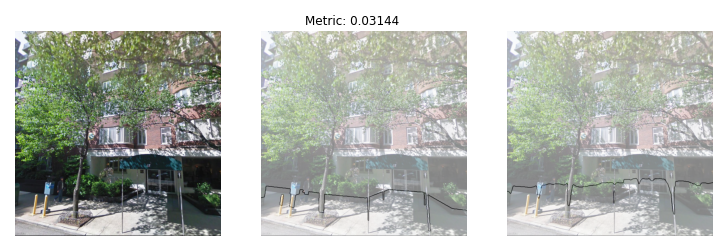

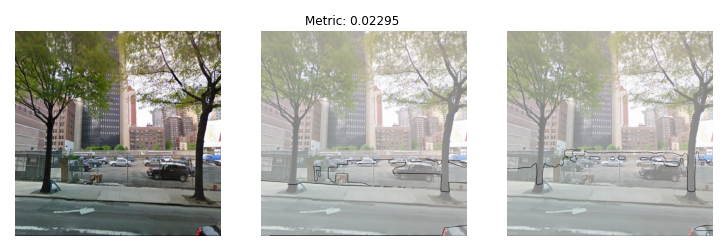

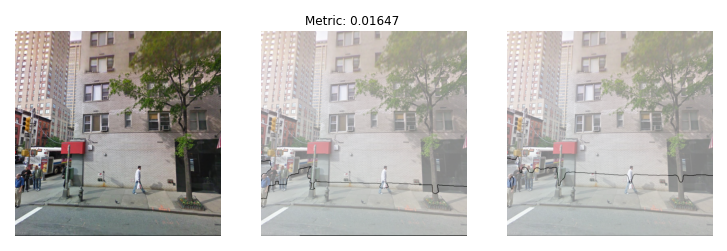

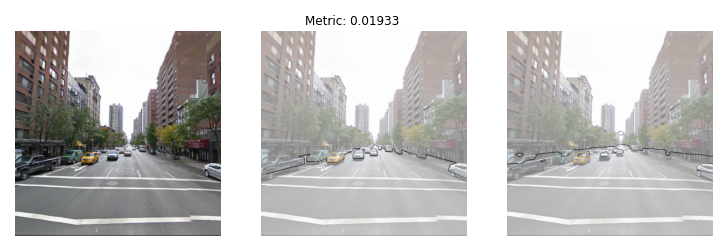

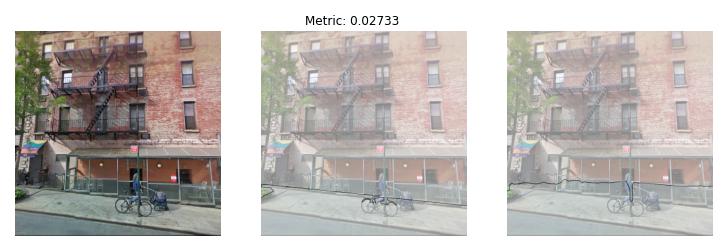

...

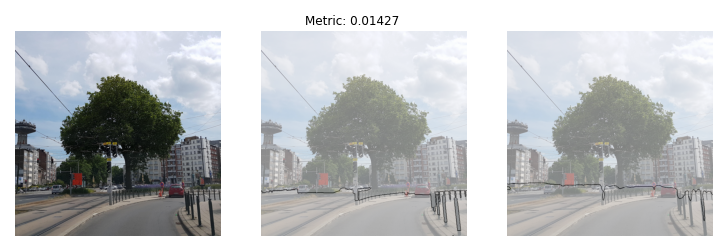

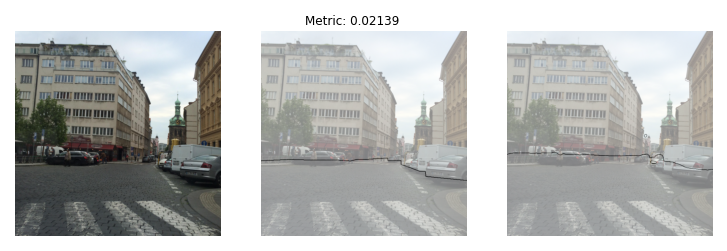

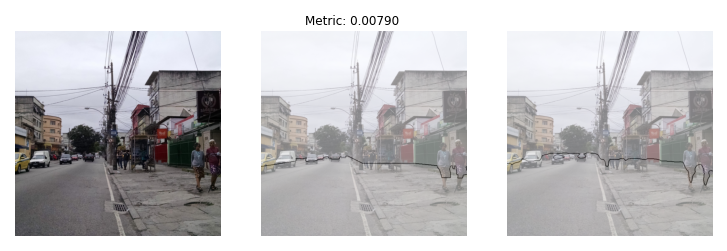

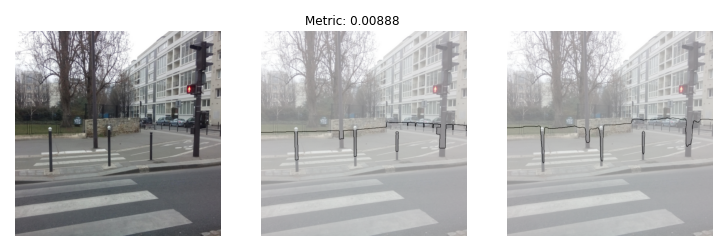

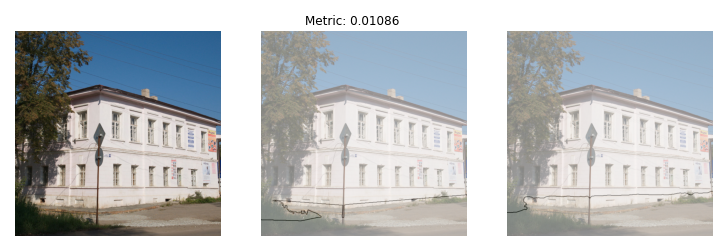

In [44]:
for idx, (img_path, label_path, pred_path) in enumerate(
        zip(*(sorted(imgs_paths), sorted(labels_paths), sorted(preds_paths)))):
    
    img = preprop_orig(imread(img_path), target_size=640)
    label = np.squeeze(preprop_label(imread(label_path), target_size=640))
    pred = preprop_pred(imread(pred_path), target_size=640)
    
    metric, pred_edge, label_edge = edge_coherence(pred, label)
        
    f = plot_edges(img, label_edge, pred_edge, dpi=150)
    
    f.suptitle('Metric: {:.5f}'.format(metric),
               fontsize='xx-small',y=0.7)
    
#     if idx >= 10:
#         break

# Playground

### FPR & FDR - Recall & Precision

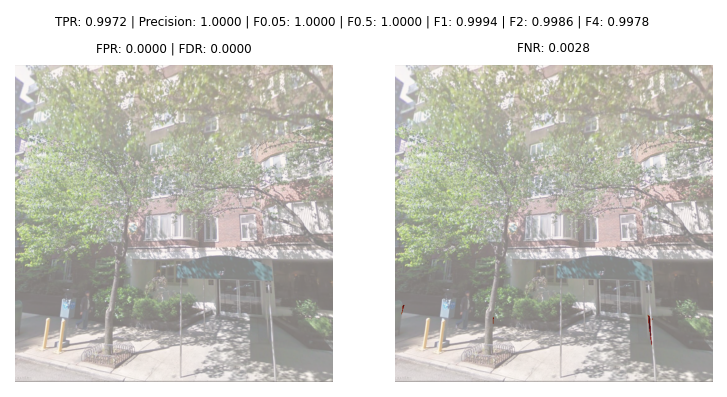

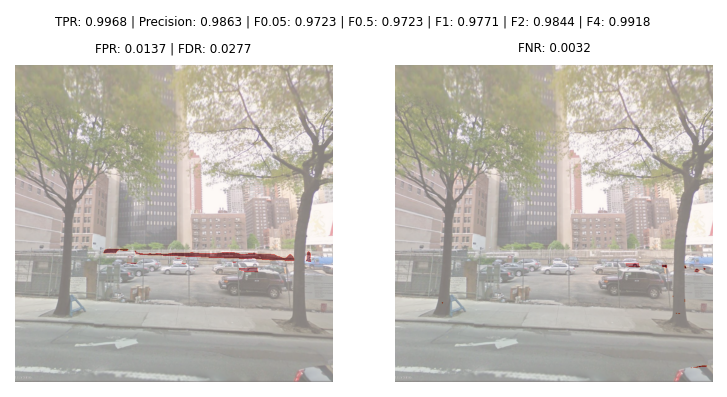

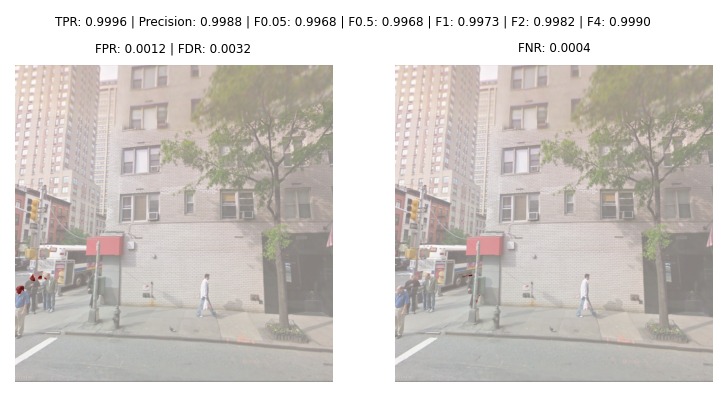

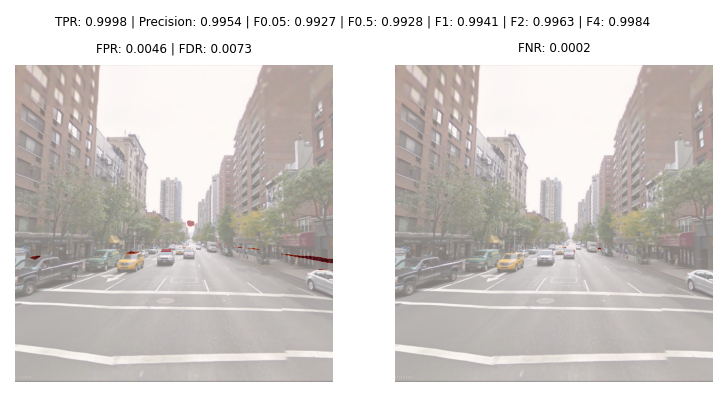

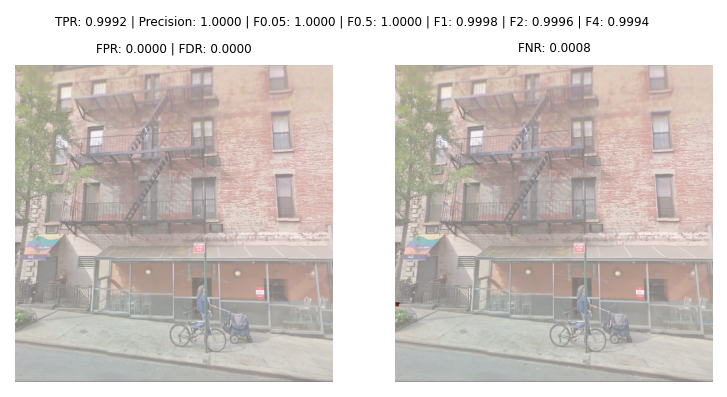

...

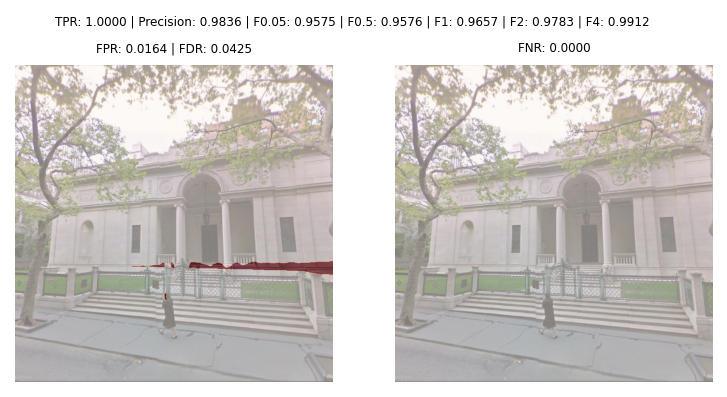

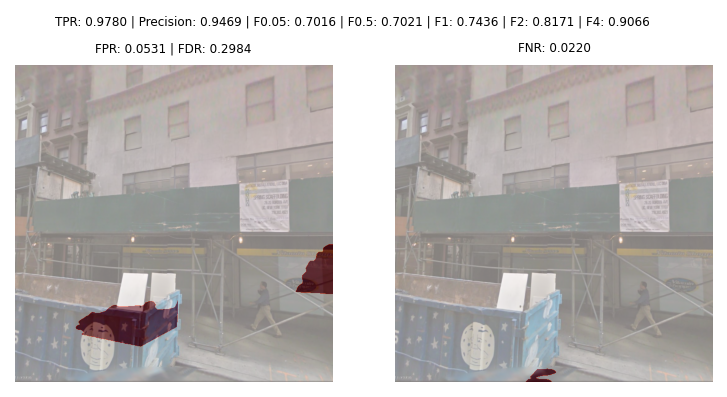

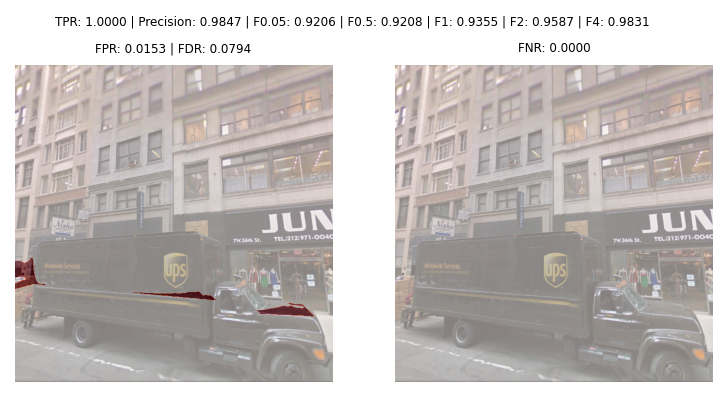

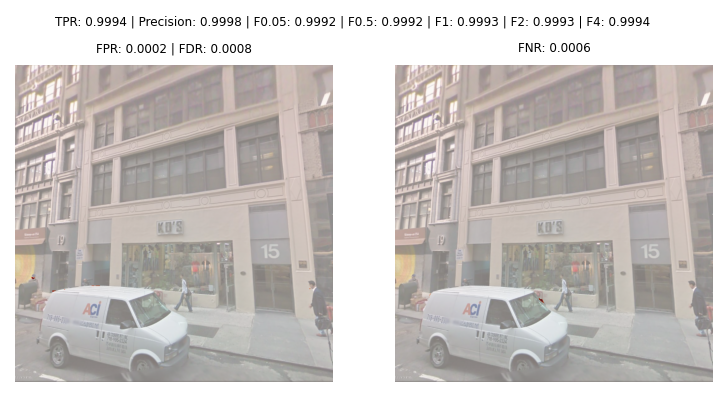

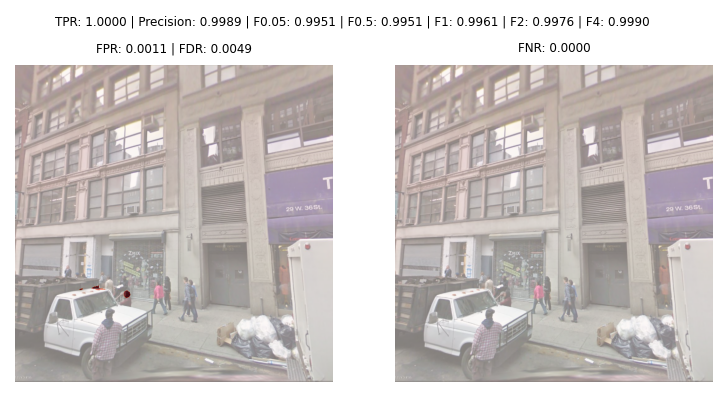

In [64]:
fpr_list = []
fnr_list = []
mnr_list = []
mpr_list = []
tpr_list = []
tnr_list = []
precision_list = []
f1_list = []
f05_list = []
f005_list = []
f2_list = []
f4_list = []
fdr_list = []

for idx, (img_path, label_path, pred_path) in enumerate(
        zip(*(sorted(imgs_paths), sorted(labels_paths), sorted(preds_paths)))):
    
    img = preprop_orig(imread(img_path), target_size=640)
    labels = preprop_label(imread(label_path), target_size=640)
    labels = np.squeeze(labels)
    pred = preprop_pred(imread(pred_path), target_size=640)  
    
    # Binarize
    pred = pred > 0.5
    
    fp_map, fpr = pred_cannot(pred, labels, label_cannot=0)
    fn_map, fnr = missed_must(pred, labels, label_must=1)
    may_neg_map, may_pos_map, mnr, mpr = may_flood(pred, labels, label_may=2)
    tpr, tnr, precision, f1, f05, f005, f2, f4 = compute_metrics(pred, labels, label_cannot=0, label_must=1)
    fdr = 1 - precision
    
    metric, pred_edge, label_edge = edge_coherence(pred, labels)
    
    f, axes = plt.subplots(1, 2, dpi=150)

    # FPR (predicted mask on cannot flood) and FDR (false discovery rate)
    axes[0].imshow(img)
    fp_map_plt = axes[0].imshow(fp_map, vmin=0., vmax=1., cmap='Reds', alpha=0.5)
    axes[0].axis('off');
    axes[0].set_title('FPR: {:.4f} | FDR: {:.4f}'.format(fpr, fdr), fontsize='xx-small')
    
    # FNR (missed mask on must flood)
    axes[1].imshow(img)
    fn_map_plt = axes[1].imshow(fn_map, vmin=0., vmax=1., cmap='Reds', alpha=0.5)
#     f.colorbar(mappable=fn_map_plt, ax=ax1, label='FNR map')
    axes[1].axis('off');
    axes[1].set_title('FNR: {:.4f}'.format(fnr), fontsize='xx-small')
    
    f.suptitle('TPR: {:.4f} | Precision: {:.4f} | F0.05: {:.4f} | F0.5: {:.4f} | F1: {:.4f} | F2: {:.4f} | F4: {:.4f}'.format(
        tpr, tnr, precision, f005, f05, f1, f2, f4),
               fontsize='xx-small',y=0.85)

    output_filename = os.path.join(data_path, 'flood_eval', img_path.name)
    output_filename = None
    if output_filename:
        f.savefig(output_filename, dpi=f.dpi, bbox_inches='tight', facecolor='white', transparent=False)
        
    clear_output(wait=True)
    
    fpr_list.append(fpr)
    fnr_list.append(fnr)
    mnr_list.append(mnr)
    mpr_list.append(mpr)
    tpr_list.append(tpr)
    tnr_list.append(tnr)
    precision_list.append(precision)
    f1_list.append(f1)
    f005_list.append(f005)
    f05_list.append(f05)
    f2_list.append(f2)
    f4_list.append(f4)
    fdr_list.append(fdr)
    
    if idx >= 10:
        break